In [3]:
import glob
import importlib

import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
import seaborn as sns
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.utils import flow_to_image
from torchvision.transforms.functional import gaussian_blur
# from matplotlib import cm


import src
import src.models
from src.network_blocks import ResizeTransform
from src.models import PULPo
from src.losses import L2_loss, Soft_dice_loss, NCC_loss, jacobian_det, JDetStd, L2_reg
import evaluate

# how to time stuff in notebooks
# %timeit for i in range(100): my_function()


In [5]:
# EVAL VISUALIZATION

#reload evaluate
importlib.reload(src)
importlib.reload(src.models)
importlib.reload(evaluate)
eval = evaluate.Evaluate()

# OASIS:
# 1 level:
# model = eval.load_model(model_dir="ssh_runs", git_hash="facdb06-seed=0-", version="version_3")
# 4 levels
# model = eval.load_model(model_dir="ssh_runs", git_hash="bc7979f-seed=0-", version="version_2")
# eval.load_data(task="oasis", segs=True, lms=False, mask=True, ndims=3)
# inputs = eval.sample_data(dataset="test")

# # BraTS:
# model = eval.load_model(model_dir="ssh_runs", git_hash="17a7bb2-seed=0-", version="version_1")
# model = eval.load_model(model_dir="ssh_runs", git_hash="d65e5bb-seed=0-", version="version_2")
# model = eval.load_model(model_dir="ssh_runs", git_hash="eed98d8-seed=0-", version="version_2")
model = eval.load_model(model_dir="ssh_runs", git_hash="18eb24e-seed=0-", version="version_5")
eval.load_data(task="brats", segs=False, lms=True, mask=False, ndims=3)
inputs = eval.sample_data(loader_name="val", index=0)

# OASIS:
# model = eval.load_model(model_dir="ssh_runs", git_hash="6e4a6d4-seed=0-", version="version_1")
# model = eval.load_model(model_dir="ssh_runs", git_hash="6e4a6d4-seed=0-", version="version_3")
# model = eval.load_model(model_dir="ssh_runs", git_hash="ec7b6f6-seed=0-", version="version_0")
# model = eval.load_model(model_dir="ssh_runs", git_hash="a3b5353-seed=0-", version="version_1")
# model = eval.load_model(model_dir="ssh_runs", git_hash="d65e5bb-seed=0-", version="version_1")
# model = eval.load_model(model_dir="ssh_runs", git_hash="eed98d8-seed=0-", version="version_1")
# model = eval.load_model(model_dir="ssh_runs", git_hash="8d371c7-seed=0-", version="version_0")
# model = eval.load_model(model_dir="ssh_runs", git_hash="18eb24e-seed=0-", version="version_3") # nondiagonal
# model = eval.load_model(model_dir="ssh_runs", git_hash="18eb24e-seed=0-", version="version_6") # nondiagonal
# eval.load_data(task="oasis", segs=False, lms=True, mask=False, ndims=3)
# inputs = eval.sample_data(loader_name="test_seg", index=7)
# inputs = eval.sample_data(loader_name="val", index=0)

# inputs[0] = eval.artifact(inputs[0], method="checkerboard", x=(100,130), y=(100,130), z=(120,150))

# preds, all_preds = eval.predict(inputs, num_samples=1, deterministic=True)
preds, all_preds = eval.predict(inputs, num_samples=20, deterministic=False)

eval.grid_size = 20
eval.visualize(inputs, preds,[eval.vis_x_pred_y,
                               eval.vis_pred_per_level,
                               eval.vis_diff_input_pred,
                               eval.vis_diff_target_pred,
                               eval.vis_final_df_per_level,
                               eval.vis_combined_df_per_level,
                               eval.vis_individual_df_per_level,
                               eval.vis_jdet,
                           # comment these out with just 1 sample:
                               eval.vis_output_var_per_level,
                               eval.vis_individual_df_var_per_level,
                               eval.vis_final_df_var_per_level,
                               eval.vis_sample_preds,
                               eval.vis_sample_dfs,
                          # comment seg stuff out when doing uncertainty
                              #  eval.vis_segx_segpred_segy,
                              #  eval.vis_segpred_per_level,
                               ],
                               all_preds=all_preds,
                              #  rowparams={6:{"flow":True, "grid":True},
                              #             7:{"flow":True, "grid":True}},
                                title="All visualizations", show=True)#, save_path=eval.output_dir + "/allvis.png")

eval.table_jdet(inputs, preds, show=True, save=False, fontsize=10)


x,y,seg_x,seg_y,lm_x,lm_y,mask_x,mask_y,_ = inputs
y_pred, df_pred, y_pred_seg, outputs, individual_dfs, combined_dfs, final_dfs, warped_seg, prediction_name = preds
if all_preds != []:
   output_std, individual_df_std, final_df_std, all_outputs, all_individual_dfs, all_combined_dfs, all_final_dfs, all_warped_seg = all_preds
latent_levels = eval.latent_levels

IndexError: list index out of range

input_size [144 192 160]
input_size [144 192 160]
input_size [144 192 160]
Number of training/validation patches: (120, 20, 20)
INPUT SIZE:  torch.Size([144, 192, 160])
LEVEL SIZES:  {0: tensor([72, 96, 80]), 1: tensor([36, 48, 40]), 2: tensor([18, 24, 20]), 3: tensor([ 9, 12, 10])}


/home/leo/new_phireg/src/models.py:458: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  self.level_sizes = {key: torch.tensor(self.input_size) // (2**(key+self.lk_offset)) for key in range(self.latent_levels)}


REGULARIZER:  L2
WINDOW SIZE:  {0: 9, 1: 7, 2: 5, 3: 3}
KL WEIGHT DICT:  {0: 1.0, 1: 8.0, 2: 64.0, 3: 512.0}
RECON WEIGHT DICT:  {0: 0.5, 1: 8.0, 2: 64.0, 3: 512.0}
REGULARIZATION WEIGHT DICT:  {0: 0.125, 1: 8.0, 2: 64.0, 3: 512.0}


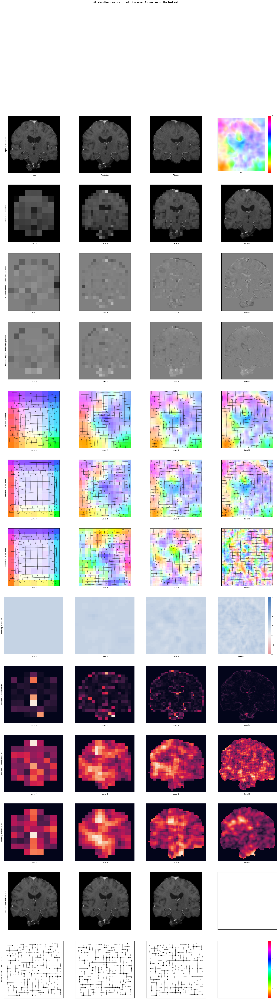

NameError: name 'x' is not defined

In [2]:
# method plot material
import glob
import importlib

import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
import seaborn as sns
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.utils import flow_to_image
from torchvision.transforms.functional import gaussian_blur
# from matplotlib import cm


import src
import src.models
from src.data import mini_reg
from src.network_blocks import ResizeTransform
from src.models import PULPo
from src.losses import L2_loss, Soft_dice_loss, NCC_loss, jacobian_det, JDetStd, L2_reg
import evaluate

eval = evaluate.Evaluate()

task = "brats"
eval.load_data(task=task, segs=False, lms=True, mask=False, ndims=3)
loader_name = "test"
index= 4
slice_percentage = 0.4
num_samples = 3

model = eval.load_model(model_dir="ssh_runs", git_hash="18eb24e-seed=0-", version="version_5")
inputs = eval.sample_data(loader_name=loader_name, index=index)
preds, all_preds = eval.predict(inputs, num_samples=num_samples, deterministic=False)

eval.grid_size = 20
eval.visualize(inputs, preds,[eval.vis_x_pred_y,
                               eval.vis_pred_per_level,
                               eval.vis_diff_input_pred,
                               eval.vis_diff_target_pred,
                               eval.vis_final_df_per_level,
                               eval.vis_combined_df_per_level,
                               eval.vis_individual_df_per_level,
                               eval.vis_jdet,
                           # comment these out with just 1 sample:
                               eval.vis_output_var_per_level,
                               eval.vis_individual_df_var_per_level,
                               eval.vis_final_df_var_per_level,
                               eval.vis_sample_preds,
                               eval.vis_sample_dfs,
                          # comment seg stuff out when doing uncertainty
                              #  eval.vis_segx_segpred_segy,
                              #  eval.vis_segpred_per_level,
                               ],
                               all_preds=all_preds,
                              #  rowparams={6:{"flow":True, "grid":True},
                              #             7:{"flow":True, "grid":True}},
                                title="All visualizations", show=True)#, save_path=eval.output_dir + "/allvis.png")


x = inputs[0]

for l in reversed(range(4)):
    # resize the final_df[l] to the size of x
    resizer = ResizeTransform(vel_resize= 1 / (x.shape[-1] / final_dfs[l].shape[-1]), ndims=3)
    print("final_dfs shape", final_dfs[l].shape)
    final_dfs[l] = resizer(final_dfs[l])
    print("final_dfs shape", final_dfs[l].shape)
print(x.shape, final_dfs[3].shape)
fs_outputs = {key: model.autoencoder.decoders[0].spatial_transform(final_dfs[key], x) for key in range(4)}

# plot all 4 levels of fs_outputs
fig, ax = plt.subplots(1, 4, figsize=(20, 5))
for i in range(4):
    ax[i].imshow(np.rot90(fs_outputs[i][0,0,:,112,:]), "gray", vmin=0, vmax=1)
    ax[i].set_title(f"Level {i}")

INPUT SIZE:  torch.Size([144, 192, 160])
LEVEL SIZES:  {0: tensor([72, 96, 80]), 1: tensor([36, 48, 40]), 2: tensor([18, 24, 20]), 3: tensor([ 9, 12, 10])}
REGULARIZER:  L2
WINDOW SIZE:  {0: 9, 1: 7, 2: 5, 3: 3}
KL WEIGHT DICT:  {0: 1.0, 1: 8.0, 2: 64.0, 3: 512.0}
RECON WEIGHT DICT:  {0: 0.5, 1: 8.0, 2: 64.0, 3: 512.0}
REGULARIZATION WEIGHT DICT:  {0: 0.125, 1: 8.0, 2: 64.0, 3: 512.0}
final_dfs shape torch.Size([1, 3, 144, 192, 160])
final_dfs shape torch.Size([1, 3, 144, 192, 160])
final_dfs shape torch.Size([1, 3, 144, 192, 160])
final_dfs shape torch.Size([1, 3, 144, 192, 160])
final_dfs shape torch.Size([1, 3, 144, 192, 160])
final_dfs shape torch.Size([1, 3, 144, 192, 160])
final_dfs shape torch.Size([1, 3, 144, 192, 160])
final_dfs shape torch.Size([1, 3, 144, 192, 160])
torch.Size([1, 1, 144, 192, 160]) torch.Size([1, 3, 144, 192, 160])


/home/leo/new_phireg/src/models.py:458: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  self.level_sizes = {key: torch.tensor(self.input_size) // (2**(key+self.lk_offset)) for key in range(self.latent_levels)}


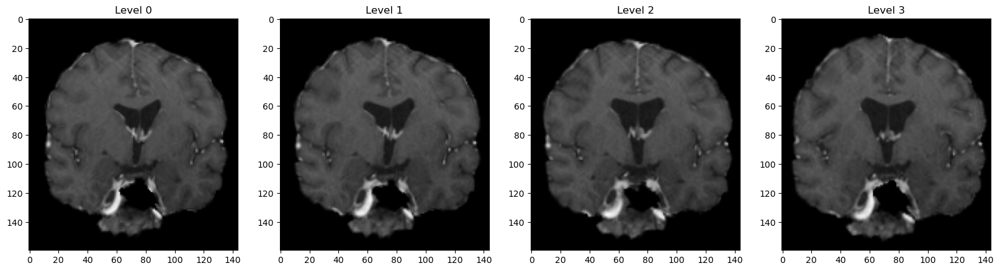

In [5]:

x = inputs[0]
final_dfs = preds[6]

model = eval.load_model(model_dir="ssh_runs", git_hash="18eb24e-seed=0-", version="version_5")


for l in reversed(range(4)):
    # resize the final_df[l] to the size of x
    resizer = ResizeTransform(vel_resize= 1 / (x.shape[-1] / final_dfs[l].shape[-1]), ndims=3)
    print("final_dfs shape", final_dfs[l].shape)
    final_dfs[l] = resizer(final_dfs[l])
    print("final_dfs shape", final_dfs[l].shape)
print(x.shape, final_dfs[3].shape)
fs_outputs = {key: model.autoencoder.decoders[0].spatial_transform(final_dfs[key], x) for key in range(4)}

# plot all 4 levels of fs_outputs
fig, ax = plt.subplots(1, 4, figsize=(20, 5))
for i in range(4):
    ax[i].imshow(np.rot90(fs_outputs[i][0,0,:,slice_index,:]), "gray", vmin=0, vmax=1)
    ax[i].set_title(f"Level {i}")

In [3]:
# LM PERFORMANCE
# reload models
importlib.reload(src)
importlib.reload(src.models)
importlib.reload(evaluate)

# warp the landmarks
print(lm_x.shape)
print(final_dfs[0].shape)
warped_lm = eval.warp_landmarks(lm_x, final_dfs[0])
print(warped_lm.shape)

naive_error = eval.lm_mae(lm_x, lm_y)
naive_tre = eval.lm_euclid(lm_x, lm_y)
print("Naive error: ", naive_error, "Naive TRE: ", naive_tre)
error = eval.lm_mae(warped_lm, lm_y)
tre = eval.lm_euclid(warped_lm, lm_y)
print("Error: ", error, "TRE: ", tre)

torch.Size([1, 32, 3])
torch.Size([1, 3, 160, 224, 192])
torch.Size([1, 32, 3])
Naive error:  tensor(3.8038) Naive TRE:  tensor(3.1291)
Error:  tensor(2.9072) TRE:  tensor(2.4092)


In [4]:
# LM UNCERTAINTY
# reload models
importlib.reload(src)
importlib.reload(src.models)
importlib.reload(evaluate)
eval = evaluate.Evaluate()

# warp the landmarks
warped_lm = eval.warp_landmarks(lm_x, all_final_dfs[0])
print(warped_lm.shape)

naive_error = eval.lm_mae(lm_x, lm_y)
print("Naive error: ", naive_error)
for i in range(4):
    error = eval.lm_mae(warped_lm[i], lm_y)
    print("Error: ", error)

# naive model
lms = lm_x.repeat(100,1,1)
# put random noise on lms
lms += torch.randn_like(lms)
print(lms.shape)
var = eval.lms_var(lms)
# print("Variance: ", var.shape)
# print("Variance ", var)
corr = eval.lms_corr(lm_x, lms, lm_y)
print("Correlation: ", corr.shape)
print("Correlation: ", corr)

# my model
lm_hat = eval.warp_landmarks(lm_x, final_dfs[0])
print(lm_hat.shape)
print(lm_y.shape)
mse = torch.mean((lm_hat - lm_y)**2,dim=-1).squeeze(0)
print("Mean error: ", mse.shape, mse.mean())
# print("Mean error: ", mse)
var = eval.lms_var(warped_lm)
print("Variance: ", var.shape, var.mean())
# print("Variance: ", var)
corr = eval.lms_corr(lm_hat, warped_lm, lm_y)
print("Correlation: ", corr.shape)
print("Correlation: ", corr)

torch.Size([4, 32, 3])
Naive error:  tensor(3.8038)
Error:  tensor(2.9206)
Error:  tensor(2.9246)
Error:  tensor(3.0115)
Error:  tensor(2.9072)
torch.Size([100, 32, 3])
Correlation:  ()
Correlation:  0.04554224
torch.Size([1, 32, 3])
torch.Size([1, 32, 3])
Mean error:  torch.Size([32]) tensor(2.7182)
Variance:  torch.Size([32]) tensor(0.0111)
Correlation:  ()
Correlation:  0.3471421


In [9]:
print(final_dfs[0].shape)
print(jacobian_det(final_dfs[0]).squeeze().shape)
print(jacobian_det(final_dfs[0]).std().shape)

torch.Size([1, 3, 160, 224, 192])


torch.Size([160, 224, 192])
torch.Size([])


In [5]:
# outputs
level_y = {0: F.avg_pool3d(y,2,2)}
for l in range(1,4):
    level_y[l] = F.avg_pool3d(level_y[l-1],2,2)
level_y[0] = y

scale_dict = {0: 0.5, 1: 8.0, 2: 64.0, 3: 512.0}


for l in range(4):
    print("Level ", l)
    # print("Output: ", outputs[l].shape)
    # print("Level y: ", level_y[l].shape)
    ncc = NCC_loss(outputs[l], level_y[l])
    print("NCC: ", scale_dict[l]*ncc)

Level  0


cc torch.Size([1, 1, 160, 224, 192])
cc torch.Size([1, 160, 224, 192])
cc sum tensor(1704727.1250)
NCC:  tensor(-8523.6357)
Level  1
cc torch.Size([1, 1, 40, 56, 48])
cc torch.Size([1, 40, 56, 48])
cc sum tensor(54349.9141)
NCC:  tensor(-4347.9932)
Level  2
cc torch.Size([1, 1, 20, 28, 24])
cc torch.Size([1, 20, 28, 24])
cc sum tensor(10195.3691)
NCC:  tensor(-6525.0361)
Level  3
cc torch.Size([1, 1, 10, 14, 12])
cc torch.Size([1, 10, 14, 12])
cc sum tensor(1470.2949)
NCC:  tensor(-7527.9102)


In [ ]:
# INVERSE DF

# Assuming displacement_field is a 3D displacement field (3 channels for x, y, z)
displacement_field = df_pred[0]

# # inverting by negating the integrated DF
# inverted = displacement_field * -1
# print(inverted.shape)

# inverting by integrating the negated combined DF
combined = combined_dfs[0]
combined_neg = combined * -1
print(combined_neg.shape)
combined_integrated = model.autoencoder.decoders[0].integrate(combined_neg)
print(combined_integrated.shape)
combined__scaled = model.autoencoder.decoders[0].resizer_output(combined_neg)
print(combined__scaled.shape)
inverted = combined__scaled

# apply inverted to y
warped_y = model.autoencoder.decoders[0].spatial_transform(inverted, y_pred)
print(warped_y.shape)

inverted = inverted.squeeze(0)

sliced_inverted = inverted[:,:,112,:]
print(sliced_inverted.shape)
sliced_inverted = torch.stack([sliced_inverted[0],sliced_inverted[2]])
print(sliced_inverted.shape)

# do the same with orginial displacement field
sliced_df = displacement_field[:,:,112,:]
print(sliced_df.shape)
sliced_df = torch.stack([sliced_df[0],sliced_df[2]])
print(sliced_df.shape)


plt.imshow(flow_to_image(sliced_df).permute(1,2,0))
plt.show()
plt.imshow(flow_to_image(sliced_inverted).permute(1,2,0))
plt.show()
plt.imshow(y_pred[0,0,:,112,:])
plt.show()
plt.imshow(warped_y[0,0,:,112,:])
plt.show()
plt.imshow(x[0,0,:,112,:])
plt.show()
plt.imshow(torch.abs(y_pred[0,0,:,112,:] - warped_y[0,0,:,112,:]))


# integrate it
# inverted = inverted.permute(1,2,3,0)
# inverted = inverted.numpy()
# inverted = inverted.squeeze()
# print(inverted.shape)
# inverted = inverted.astype(np.float32)


NameError: name 'df_pred' is not defined

3D UNCERTAINTY VISUALIZATION

INPUT SIZE:  torch.Size([160, 224, 192])
REGULARIZER:  L2
WINDOW SIZE:  {0: 9, 1: 7, 2: 5, 3: 3}
Number of training/test/validation patches: (365, 30, 19)


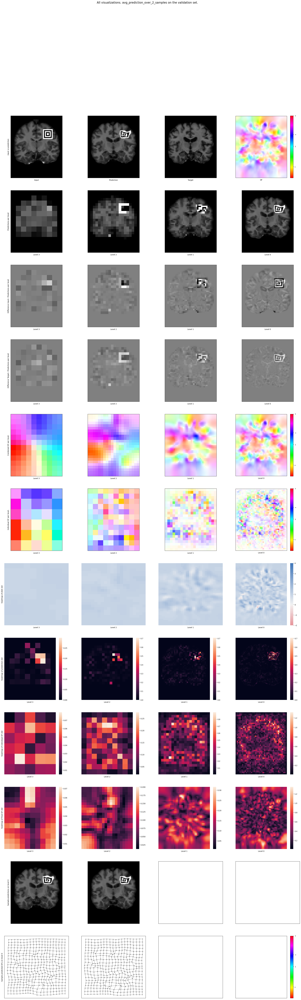

In [ ]:
#reload evaluate
importlib.reload(src)
importlib.reload(src.models)
importlib.reload(evaluate)
eval = evaluate.Evaluate()


model = eval.load_model(model_dir="ssh_runs", git_hash="f2be6fb-seed=0-", version="version_12")
eval.load_data(task="oasis", segs=True, ndims=3)
inputs = eval.sample_data(dataset="validation")
inputs[0] = eval.artifact(inputs[0], method="checkerboard", x=(100,130), y=(100,130), z=(120,150))
preds, all_preds = eval.predict(inputs, num_samples=2)

eval.grid_size = 20
eval.visualize(inputs, preds,[eval.vis_x_pred_y,
                               eval.vis_pred_per_level,
                               eval.vis_diff_input_pred,
                               eval.vis_diff_target_pred,
                               eval.vis_combined_df_per_level,
                               eval.vis_individual_df_per_level,
                               eval.vis_jdet,
                               eval.vis_output_var_per_level,
                               eval.vis_individual_df_var_per_level,
                               eval.vis_final_df_var_per_level,
                               eval.vis_sample_preds,
                               eval.vis_sample_dfs,
                               ],
                               all_preds=all_preds,
                               rowparams={4:{"flow":True, "grid":False},
                                          5:{"flow":True, "grid":False}},
                                title="All visualizations", show=True)#, save_path=eval.output_dir + "/allvis.png")




In [4]:
# Visualize voxelmorph
importlib.reload(evaluate)
eval = evaluate.Evaluate()


# model = eval.load_vxm(model_dir="models", name="vxm_ndims_3_prob_True_beta_1.0_pl20.0_epoch_1200")
# model = eval.load_vxm(model_dir="models", name="vxm_lm_oasis_ndims_3_mse_prob_True_beta_1.0_pl20.0_epoch_1499")
model = eval.load_vxm(model_dir="models", name="vxm_lm_oasis_ndims_3_ncc_prob_True_beta_20.0_pl20.0_epoch_1499")
eval.load_data(task="oasis", segs=False, lms=True, mask=False, ndims=3)
inputs = eval.sample_data(loader_name="test_lm",index=4)
# inputs[0] = eval.artifact(inputs[0], method="checkerboard", x=(100,130), y=(100,130), z=(120,150))
# preds, all_preds = eval.predict_vxm(inputs, num_samples=1, deterministic=True)
preds, all_preds = eval.predict_vxm(inputs[0], inputs[1], num_samples=4, deterministic=False)

CAREFUL: Landmarks for LM_OASIS exists only for the test_lm split
Number of training/validation/test_seg/test_lm patches: (354, 30, 30, 30)


In [7]:
print((preds[0]**2).mean())

tensor(0.0221)


In [ ]:
# Visualize voxelmorph
importlib.reload(evaluate)
eval = evaluate.Evaluate()


# model = eval.load_vxm(model_dir="models", name="vxm_ndims_3_prob_True_beta_1.0_pl20.0_epoch_1200")
# model = eval.load_vxm(model_dir="models", name="vxm_lm_oasis_ndims_3_mse_prob_True_beta_1.0_pl20.0_epoch_1499")
model = eval.load_vxm(model_dir="models", name="vxm_lm_oasis_ndims_3_ncc_prob_True_beta_20.0_pl20.0_epoch_1499")
eval.load_data(task="oasis", segs=False, lms=True, mask=False, ndims=3)
inputs = eval.sample_data(loader_name="test_lm")
# inputs[0] = eval.artifact(inputs[0], method="checkerboard", x=(100,130), y=(100,130), z=(120,150))
# preds, all_preds = eval.predict_vxm(inputs, num_samples=1, deterministic=True)
preds, all_preds = eval.predict_vxm(inputs[0], inputs[1], num_samples=4, deterministic=False)

CAREFUL: Landmarks for LM_OASIS exists only for the test_lm split
Number of training/validation/test_seg/test_lm patches: (354, 30, 30, 30)


torch.Size([1, 36, 160, 224, 192])
torch.Size([1, 36, 160, 224, 192])


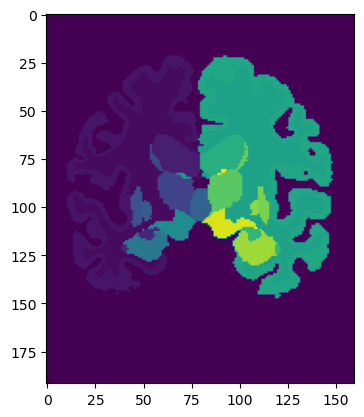

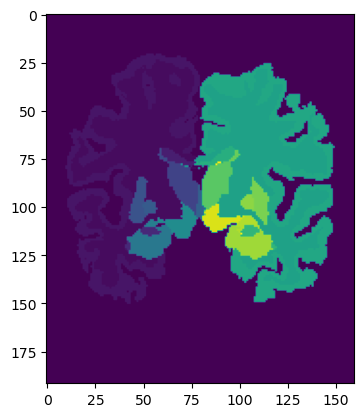

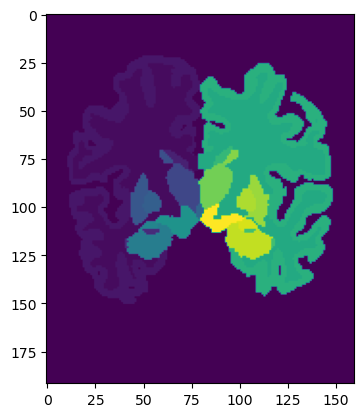

In [5]:
# Warp Segmap with VXM

from voxelmorph.torch.layers import SpatialTransformer

st_vxm = SpatialTransformer([160, 224, 192])
seg_x = inputs[2]
seg_y = inputs[3]
seg_y_pred = st_vxm(seg_x, preds[1])

print(seg_y_pred.shape)
print(seg_y.shape)
seg_x = seg_x[0].argmax(0)
seg_y = seg_y[0].argmax(0)
seg_y_pred = seg_y_pred[0].argmax(0)

# Visualize
plt.imshow(np.rot90(seg_x[:,112,:]))
plt.show()

plt.imshow(np.rot90(seg_y_pred[:,112,:]))
plt.show()
plt.imshow(np.rot90(seg_y[:,112,:]))
plt.show()


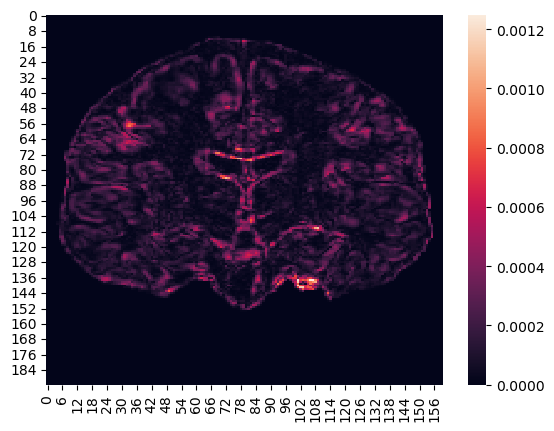

torch.Size([1, 160, 224, 192])


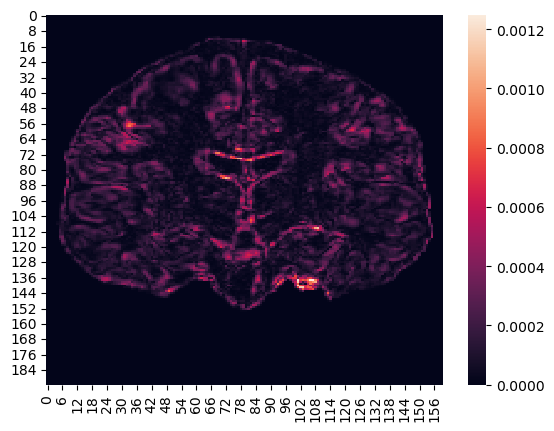

In [9]:
# check if uncertainty plot from paper was correct
sns.heatmap(np.rot90(all_preds[0][:,112,:]))#,vmin=0,vmax=0.3)
plt.show()
print(torch.std(all_preds[3],axis=0).shape)
sns.heatmap(np.rot90(torch.std(all_preds[3],axis=0)[0][:,112,:]))
plt.show()

In [10]:
mse = np.array(torch.mean((all_preds[3] - inputs[1])**2, axis=0).squeeze(0).to("cpu"))
var = np.array(all_preds[0]**2)
print(mse.shape)
print(var.shape)
ncc = eval.ncc(var, mse)
print(f"NCC of VXM prediction: {ncc}")


(160, 224, 192)
(160, 224, 192)
NCC of VXM prediction: 0.19028428196907043


In [4]:
warp_var = all_preds[3] ** 2
print("mean,min,max: ", warp_var.mean(), warp_var.min(), warp_var.max())

mean,min,max:  tensor(0.0218) tensor(0.) tensor(0.4564)


Visualize voxelmorph

torch.Size([1, 1, 160, 192])
torch.Size([1, 3, 160, 192])
torch.Size([1, 1, 160, 192])
torch.Size([1, 2, 160, 192])
torch.Size([160, 192, 3])
torch.Size([160, 224, 192])
tensor(0.9939)
tensor(0.1463)
0.00018891834077380953


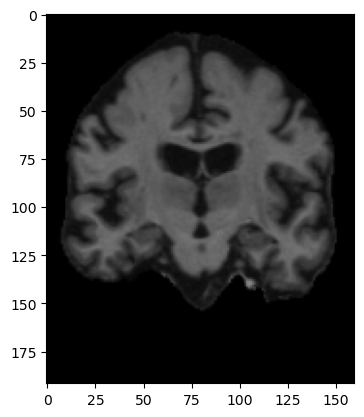

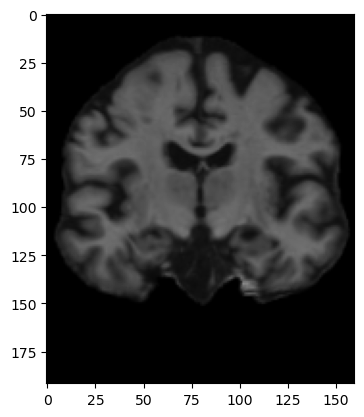

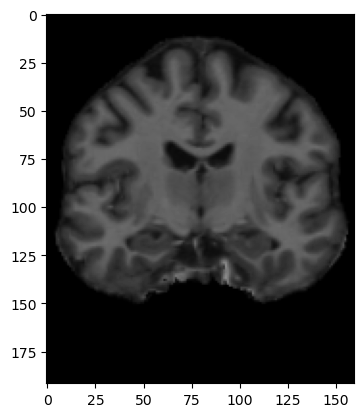

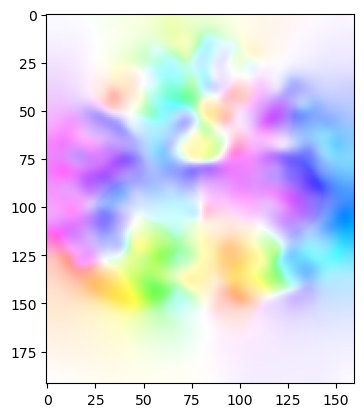

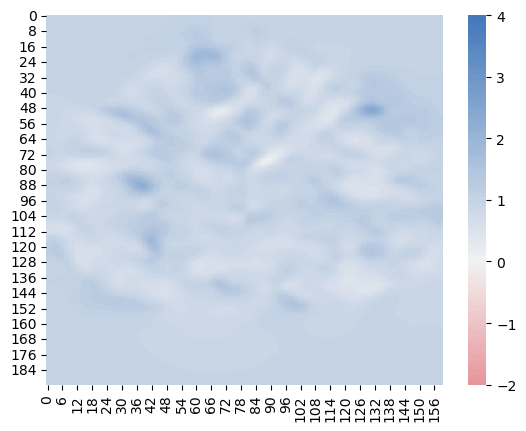

In [3]:
moved = preds[0]
warp = preds[1]

# slice it
moved2 = moved[...,:,112,:]
warp2 = warp[...,:,112,:]
print(moved2.shape)
print(warp2.shape)
warp2 = torch.stack([warp2[...,0,:,:], warp2[...,2,:,:]],dim=-3)
print(moved2.shape)
print(warp2.shape)
warp2 = flow_to_image(warp2).permute(0,2,3,1)[0]
print(warp2.shape)

jdet = jacobian_det(warp)[0].detach()
# jdet = jacobian_det(warp)[...,:,112,:][0].detach()
print(jdet.shape)
print(jdet.mean())
print(jdet.std())
jdet_leq0 = np.where(jdet <= 0, 1, 0)
print((np.sum(jdet_leq0==1) / np.sum(np.ones_like(jdet_leq0)))*100)

plt.imshow(np.rot90(inputs[0][...,:,112,:][0,0]), 'gray',vmin=0,vmax=1)
plt.show()
plt.imshow(np.rot90(moved2[0,0]), 'gray',vmin=0,vmax=1)
plt.show()
plt.imshow(np.rot90(inputs[1][...,:,112,:][0,0]), 'gray',vmin=0,vmax=1)
plt.show()
plt.imshow(np.rot90(warp2))
plt.show()
sns.heatmap(np.rot90(jdet[...,:,112,:]), cmap=sns.diverging_palette(10,250,sep=1,n=100), center=0., vmin=-2,vmax=4)
plt.show()

In [5]:
inshape = moved.shape[2:]
print("RMSE: ", np.sqrt(L2_loss(moved, inputs[1]) / np.prod(inshape)))
print("DSC: ", 1 - Soft_dice_loss(seg_x, transformed_seg, dice_factor=1) / np.prod(inshape))
# print(1 - Soft_dice_loss(inputs[0], moved, dice_factor=1) / np.prod(inshape))
# print(1 - Soft_dice_loss(inputs[0][...,40:180], moved[...,40:180], dice_factor=1) / np.prod(inshape))

RMSE:  tensor(0.0382)


NameError: name 'seg_x' is not defined

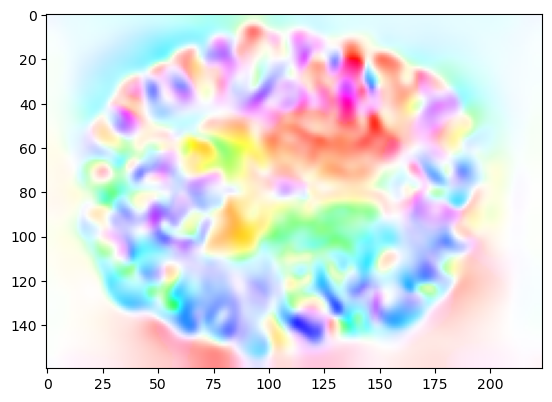

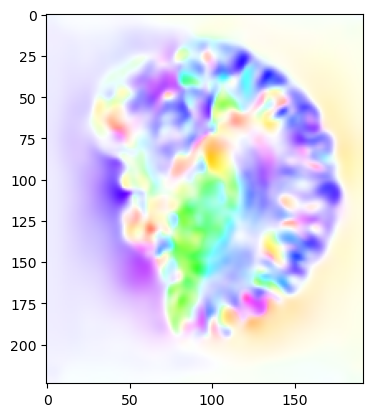

In [ ]:
from matplotlib import pyplot, image, transforms
warp2 = warp[...,:,:,100]
warp2 = torch.stack([warp2[...,0,:,:], warp2[...,2,:,:]],dim=-3)
warp2 = flow_to_image(warp2).permute(0,2,3,1)[0]
fig, ax = plt.subplots()
ax.imshow(warp2)
plt.show()
warp2 = warp[...,100,:,:]
warp2 = torch.stack([warp2[...,0,:,:], warp2[...,2,:,:]],dim=-3)
warp2 = flow_to_image(warp2).permute(0,2,3,1)[0]
plt.imshow(warp2)
plt.show()

In [ ]:
print(NCC_loss(x,y,win_size=9,gamma=0.05))
print(NCC_loss(y_pred,y,win_size=9,gamma=0.05))
print(NCC_loss(x,y,win_size=3,gamma=0.05))
print(NCC_loss(y_pred,y,win_size=3,gamma=0.05))

tensor(-302.6428)
tensor(-535.3647)
tensor(-304.4693)
tensor(-405.0757)


In [ ]:
# to draw a letter

import torchvision.transforms as transforms
from PIL import Image, ImageDraw, ImageFont

# Assuming you have an image represented as a PyTorch tensor
# image_tensor = inputs[0][0]

# # Convert the PyTorch tensor to a PIL Image
# image_pil = transforms.ToPILImage()(image_tensor)

# # Create a PIL ImageDraw object
# draw = ImageDraw.Draw(image_pil)

# # Define the letter 'A' parameters
# letter = 'A'
# font_size = 70
# font_color = (255, 0, 0)  # Red color

# # Load a suitable font
# font = ImageFont.load_default()

# # Determine the position to draw the letter
# letter_position = (90, 90)

# # Draw the letter on the PIL Image
# draw.text(letter_position, letter, font=font,font_size=font_size)#, fill=font_color)

# # Convert the modified PIL Image back to a PyTorch tensor
# modified_image_tensor = transforms.ToTensor()(image_pil)

# # Ensure the shape of the modified tensor matches the input tensor
# modified_image_tensor = modified_image_tensor.view(image_tensor.shape)

# inputs[0][0] = modified_image_tensor

In [ ]:
def ce_error_map_samples(gt_annot):
    """
    computes error map between mean_gt annotation and individual segmentations
    params:
        gt_annot: torch tensor in shape (n_annotations, n_channels, d1, d2)
    returns: numpy array with shape (n_annotations, n_channels, d1, d2). Contains the cross entropy errors between mean gt annotation and individual gt annotations
    """

    cross_entropy = torch.nn.CrossEntropyLoss(reduction='none')
    
    gt_annot_onehot = F.one_hot(torch.Tensor(gt_annot).long(), num_classes=36).permute((0,3,1,2))

    mean_annot = torch.mean(gt_annot_onehot.float(), dim=0).unsqueeze(0)#.softmax(dim=0).unsqueeze(0)
    

    ce_errors = []
    for i in range(len(gt_annot)):
        ce_loss = cross_entropy(input=mean_annot, target=torch.Tensor(gt_annot[i]).unsqueeze(0).long()).squeeze().numpy()
        ce_errors.append(ce_loss)
    return np.mean(np.array(ce_errors), axis=0)


def ce_error_map_gts(gt, samples):
    """
    computes error map between mean_gt annotation and individual segmentations
    params:
        gt_annot: torch tensor in shape (n_annotations, n_channels, d1, d2)
    returns: numpy array with shape (n_annotations, n_channels, d1, d2). Contains the cross entropy errors between mean gt annotation and individual gt annotations
    """

    cross_entropy = torch.nn.CrossEntropyLoss(reduction='none')
    
    annot_samples = F.one_hot(torch.Tensor(samples).long(), num_classes=36).permute((0,3,1,2))

    mean_annot = torch.mean(annot_samples.float(), dim=0).unsqueeze(0)#.softmax(dim=0).unsqueeze(0)
    


    ce_loss = cross_entropy(input=mean_annot, target=torch.Tensor(gt).unsqueeze(0).long()).squeeze().numpy()

    return np.array(ce_loss)

def ncc(a,v, zero_norm=True):
    """Computes the normalized cross correaltion between two arrays

    Args:
        a (np.array): first array
        v (np.array): second array

    Returns:
        float: the normalized cross correlation between arrays a and v
    """
    a = a.flatten()
    v = v.flatten()
    eps = 1e-15
    if zero_norm:

        a = (a - np.mean(a)) / (np.std(a) * len(a) + eps)
        v = (v - np.mean(v)) / (np.std(v) + eps)

    else:

        a = (a) / (np.std(a) * len(a) + eps)
        v = (v) / (np.std(v) + eps)

    return np.correlate(a, v)


torch.Size([20, 1, 160, 192])
torch.Size([1, 1, 160, 192])
torch.Size([20, 1, 160, 192])


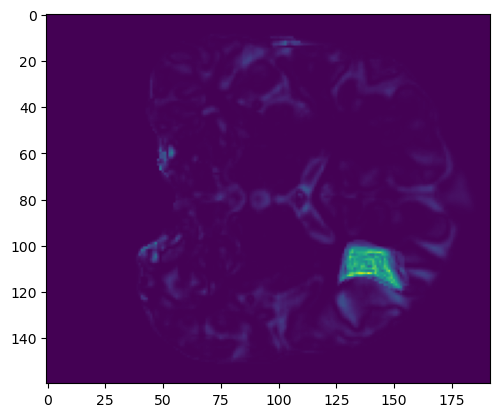

In [ ]:
print(all_outputs[0].shape)
print(y.shape)
print((all_outputs[0]-y).shape)
mse = np.array(((all_outputs[0]-y)**2).mean(axis=0).squeeze(0))
plt.imshow(mse)

OUTPUT NCC: [0.5975283]
OUTPUT NCC: [0.5975283]


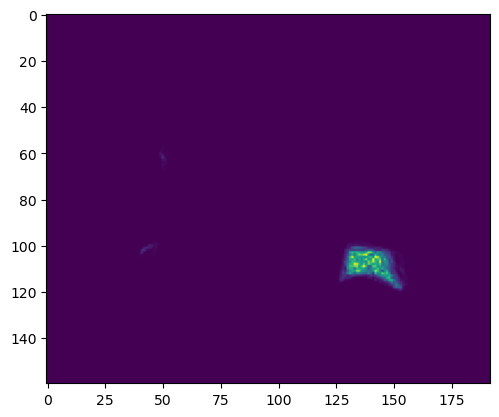

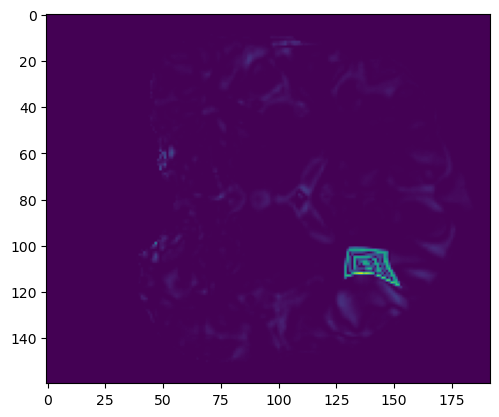

Fake DF NCC: [0.12001905]


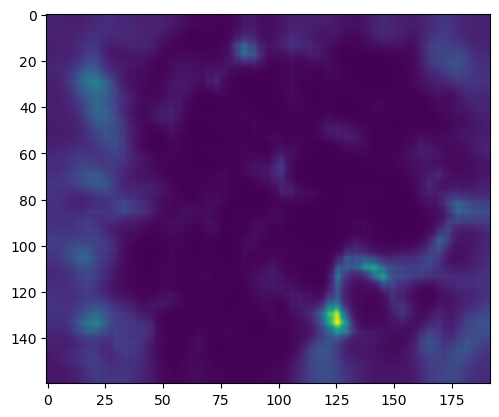

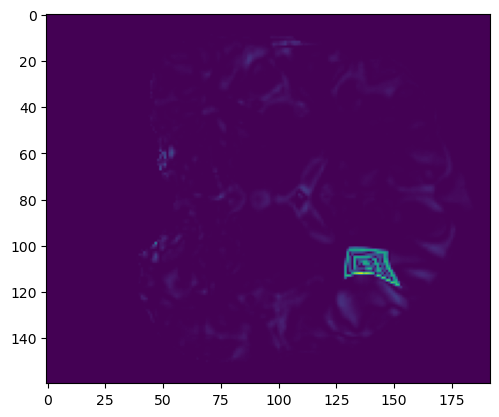

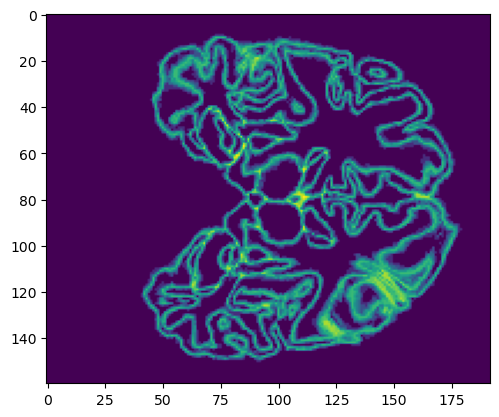

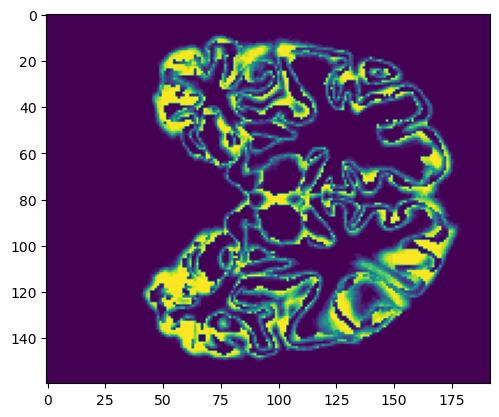

Dice NCC [0.5807346]


In [ ]:
output_var = np.array(output_std[0]**2)
se = np.array((y_pred - y).squeeze(0).squeeze(0)**2)
# do we need the MEAN of the SE for all samples??
mse = np.array((y_pred - y).squeeze(0).squeeze(0)**2)
coco = ncc(output_var, se)
print("OUTPUT NCC:",coco)
coco = ncc(output_var, mse)
print("OUTPUT NCC:",coco)
plt.imshow(output_var)
plt.show()
plt.imshow(se)
plt.show()

## NCC of Var and SE - DFS
df_var = np.array(final_df_std[0]**2)
se = np.array((y_pred - y).squeeze(0).squeeze(0)**2)
coco = ncc(df_var, se)
print("Fake DF NCC:",coco)
plt.imshow(df_var)
plt.show()
plt.imshow(se)
plt.show()

res = ce_error_map_samples(all_warped_seg[0].argmax(1))
res2 = ce_error_map_gts(seg_y.argmax(1).squeeze(0),all_warped_seg[0].argmax(1))
plt.imshow(res)
plt.show()
plt.imshow(res2)
plt.show()

res2 = res2
res = res
my_cc = ncc(res, res2)
print("Dice NCC", my_cc)

In [ ]:
def ce_error_map_samples(gt_annot):
    """
    computes error map between mean_gt annotation and individual segmentations
    params:
        gt_annot: torch tensor in shape (n_annotations, n_channels, d1, d2)
    returns: numpy array with shape (n_annotations, n_channels, d1, d2). Contains the cross entropy errors between mean gt annotation and individual gt annotations
    """

    cross_entropy = torch.nn.CrossEntropyLoss(reduction='none')
    
    gt_annot_onehot = F.one_hot(torch.Tensor(gt_annot).long(), num_classes=36).permute((0,3,1,2))

    mean_annot = torch.mean(gt_annot_onehot.float(), dim=0).unsqueeze(0)#.softmax(dim=0).unsqueeze(0)
    

    ce_errors = []
    for i in range(len(gt_annot)):
        ce_loss = cross_entropy(input=mean_annot, target=torch.Tensor(gt_annot[i]).unsqueeze(0).long()).squeeze().numpy()
        ce_errors.append(ce_loss)
    return np.mean(np.array(ce_errors), axis=0)


def ce_error_map_gts(gt, samples):
    """
    computes error map between mean_gt annotation and individual segmentations
    params:
        gt_annot: torch tensor in shape (n_annotations, n_channels, d1, d2)
    returns: numpy array with shape (n_annotations, n_channels, d1, d2). Contains the cross entropy errors between mean gt annotation and individual gt annotations
    """

    cross_entropy = torch.nn.CrossEntropyLoss(reduction='none')
    
    annot_samples = F.one_hot(torch.Tensor(samples).long(), num_classes=36).permute((0,3,1,2))

    mean_annot = torch.mean(annot_samples.float(), dim=0).unsqueeze(0)#.softmax(dim=0).unsqueeze(0)
    


    ce_loss = cross_entropy(input=mean_annot, target=torch.Tensor(gt).unsqueeze(0).long()).squeeze().numpy()

    return np.array(ce_loss)

def ncc(a,v, zero_norm=True):
    """Computes the normalized cross correaltion between two arrays

    Args:
        a (np.array): first array
        v (np.array): second array

    Returns:
        float: the normalized cross correlation between arrays a and v
    """
    a = a.flatten()
    v = v.flatten()
    eps = 1e-15
    if zero_norm:

        a = (a - np.mean(a)) / (np.std(a) * len(a) + eps)
        v = (v - np.mean(v)) / (np.std(v) + eps)

    else:

        a = (a) / (np.std(a) * len(a) + eps)
        v = (v) / (np.std(v) + eps)

    return np.correlate(a, v)


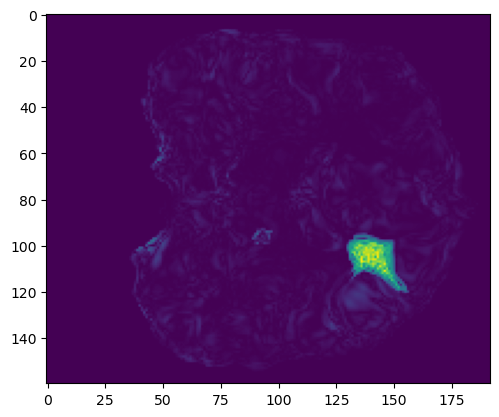

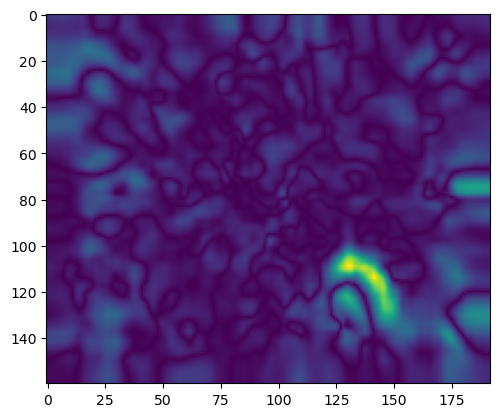

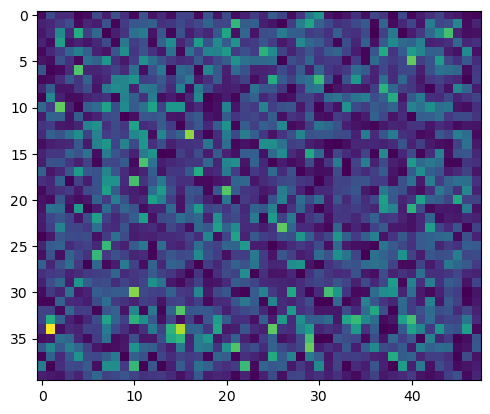

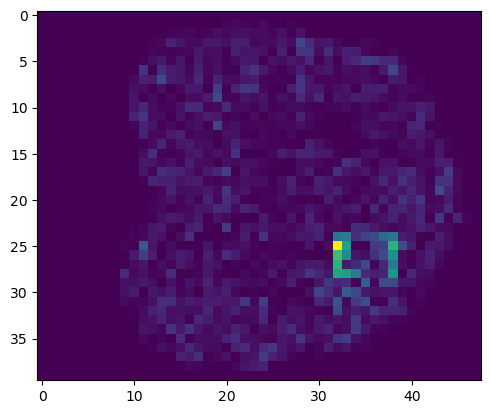

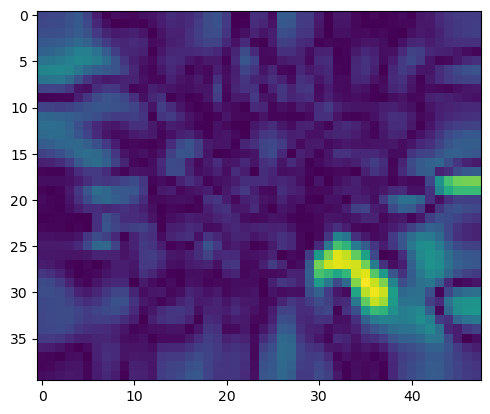

...

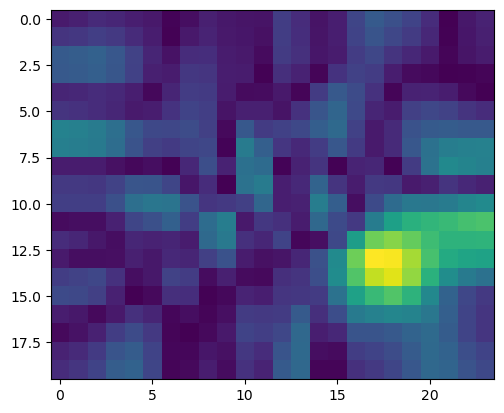

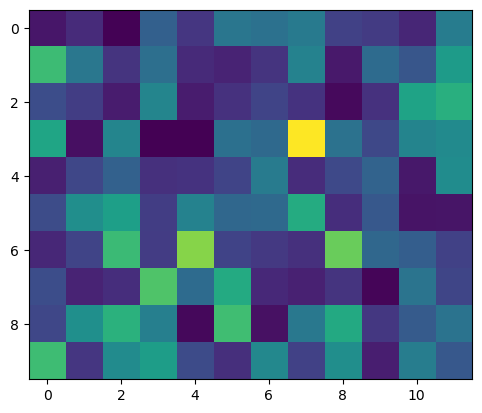

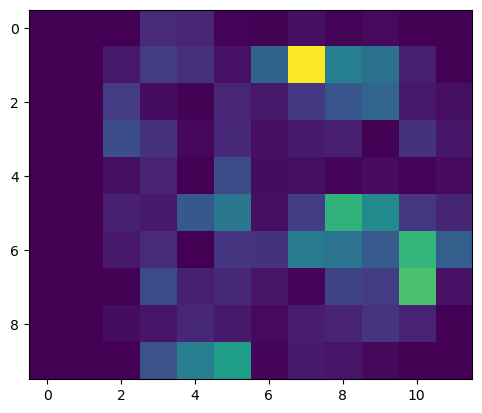

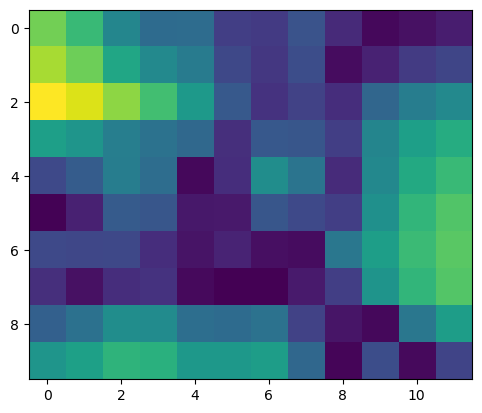

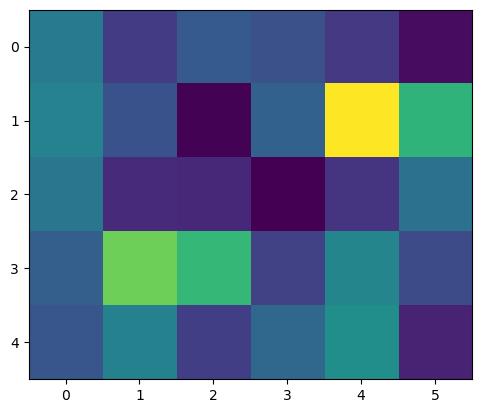

In [ ]:
# with_block_out = output_std
# with_block_df = final_df_std
# with_block_dfi = individual_df_std
no_block_out = output_std
no_block_df = final_df_std
no_block_dfi = individual_df_std

for l in range(4):
    plt.imshow(torch.abs(with_block_out[l]-no_block_out[l]))
    plt.show()
    plt.imshow(torch.abs(with_block_df[l]-no_block_df[l]))
    plt.show()
    plt.imshow(torch.abs(with_block_dfi[l]-no_block_dfi[l]))
    plt.show()

torch.Size([1, 1, 160, 192])
torch.Size([1, 1, 160, 192])
3.61 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
192 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
208 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
[tensor(-92.9052), tensor(-141.3619), tensor(-373.4898)]
[tensor(229.5628), tensor(132.9913), tensor(0.)]
[tensor(140.4007), tensor(78.9684), tensor(0.)]


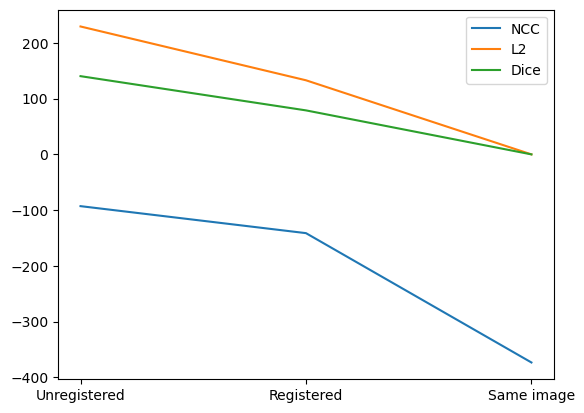

Number of training/test/validation patches: (365, 30, 19)
3.04 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
14.1 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
22.4 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


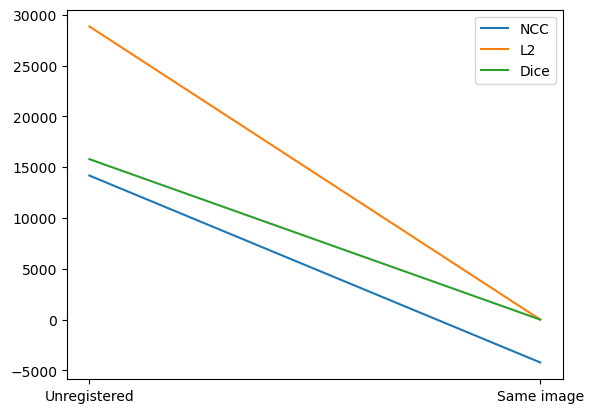

In [ ]:
# test NCC

import math

def NCC_loss(y_true, y_pred, win_size=9, gamma=0.05, ncc_offset=150):

        Ii = y_true
        Ji = y_pred

        # get dimension of volume
        ndims = len(Ii.size()[2:])
        assert ndims in [2, 3], "volumes should be 1 to 3 dimensions. found: %d" % ndims

        # set window size
        win = [win_size] * ndims
        
        # compute filters
        sum_filt = torch.ones([1, 1, *win])

        pad_no = math.floor(win[0] / 2)

        if ndims == 2:
            stride = (1, 1)
            padding = (pad_no, pad_no)
        else:
            stride = (1, 1, 1)
            padding = (pad_no, pad_no, pad_no)

        # get convolution function
        Conv = getattr(F, 'conv%dd' % ndims)

        # compute CC squares
        I2 = Ii * Ii
        J2 = Ji * Ji
        IJ = Ii * Ji

        I_sum = Conv(Ii, sum_filt, stride=stride, padding=padding)
        J_sum = Conv(Ji, sum_filt, stride=stride, padding=padding)
        I2_sum = Conv(I2, sum_filt, stride=stride, padding=padding)
        J2_sum = Conv(J2, sum_filt, stride=stride, padding=padding)
        IJ_sum = Conv(IJ, sum_filt, stride=stride, padding=padding)

        win_size = np.prod(win)
        u_I = I_sum / win_size
        u_J = J_sum / win_size

        cross = IJ_sum - u_J * I_sum - u_I * J_sum + u_I * u_J * win_size
        I_var = I2_sum - 2 * u_I * I_sum + u_I * u_I * win_size
        J_var = J2_sum - 2 * u_J * J_sum + u_J * u_J * win_size

        cc = cross * cross / (I_var * J_var + 1e-8)

        cc = torch.mean(cc, dim=0)
        return -torch.sum(cc) / gamma + ncc_offset


# TEST IN 2D
importlib.reload(evaluate)
eval = evaluate.Evaluate()
# eval.load_data(task="oasis", segs=True, ndims=2)
# inputs = eval.sample_data(dataset="train")
# x = inputs[0]
# y = inputs[1]

print(x.shape)
print(y.shape)
nccs = []
l2s = []
dice = []
gamma=0.05
ncc_offset=0
dice_factor=20

# unregistered
%timeit -r 1 -n 1 nccs.append(NCC_loss(x, y, gamma=gamma, ncc_offset=ncc_offset))
%timeit -r 1  -n 1 l2s.append(L2_loss(x, y))
%timeit -r 1  -n 1 dice.append(Soft_dice_loss(x, y, dice_factor=dice_factor))

# # registered
nccs.append(NCC_loss(y_pred, y, gamma=gamma, ncc_offset=ncc_offset))
l2s.append(L2_loss(y_pred, y))
dice.append(Soft_dice_loss(y_pred, y, dice_factor=dice_factor))

# same image
nccs.append(NCC_loss(y, y, gamma=gamma, ncc_offset=ncc_offset))
l2s.append(L2_loss(y, y))
dice.append(Soft_dice_loss(y, y, dice_factor=dice_factor))

print(nccs)
print(l2s)
print(dice)

plt.plot([0,1,2], nccs, label="NCC")
plt.plot([0,1,2], l2s, label="L2")
plt.plot([0,1,2], dice, label="Dice")
plt.xticks([0,1,2], ["Unregistered", "Registered", "Same image"])
# plt.yscale("symlog")
plt.legend()
plt.show()


# TEST IN 3D
eval.load_data(task="oasis", segs=True, ndims=3)
inputs = eval.sample_data(dataset="train")
x = inputs[0]
y = inputs[1]

nccs = []
l2s = []
dice = []
gamma=0.05
ncc_offset=20000
dice_factor=50

# unregistered
%timeit -r 1  -n 1 nccs.append(NCC_loss(x, y, gamma=gamma, ncc_offset=ncc_offset))
%timeit -r 1  -n 1 l2s.append(L2_loss(x, y))
%timeit -r 1  -n 1 dice.append(Soft_dice_loss(x, y, dice_factor=dice_factor))
# same image
nccs.append(NCC_loss(y, y, gamma=gamma, ncc_offset=ncc_offset))
l2s.append(L2_loss(y, y))
dice.append(Soft_dice_loss(y, y, dice_factor=dice_factor))

plt.plot([0,1], nccs, label="NCC")
plt.plot([0,1], l2s, label="L2")
plt.plot([0,1], dice, label="Dice")
plt.xticks([0,1], ["Unregistered", "Same image"])
# plt.yscale("symlog")
plt.legend()
plt.show()

In [ ]:
print(len(nccs))

8113


VISUALIZATION OF MY CONTROL POINT SPACING COMPARED TO THAT OF CLASSICAL FFD ALGORITHMS AND NIFTYREG

torch.Size([1, 1, 80, 96])
torch.Size([1, 1, 40, 48])


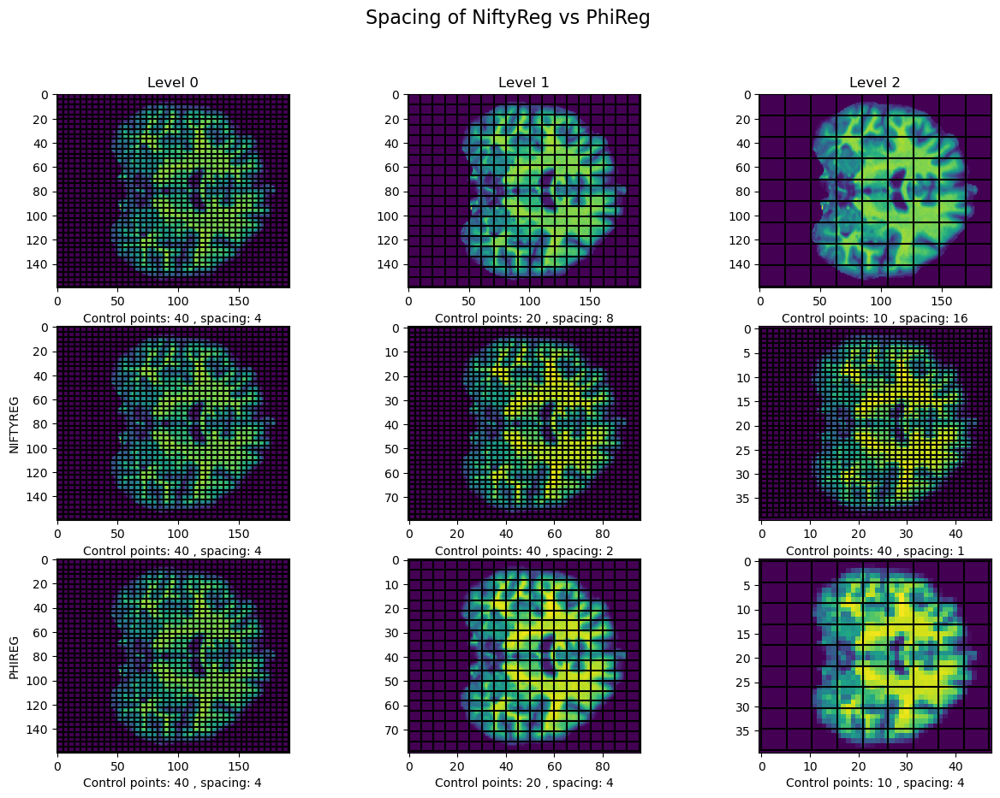

In [ ]:
x,y,seg_x,seg_y,_ = inputs
levels = 3
level_x = {0:x}
for l in range(1, levels):
    level_x[l] = F.avg_pool2d(level_x[l-1], 2, stride=2)
    print(level_x[l].shape)

fig,ax = plt.subplots(3,levels,figsize=(15,10))
# add figure title
fig.suptitle("Spacing of NiftyReg vs PULPo", fontsize=16)
grid_sizes_me = [40,20,10]
grid_sizes_ffd = [40,20,10]
grid_sizes_nifti = [40,40,40]
for l in range(levels):
    ax[0,l].imshow(x[0,0])
    ax[1,l].imshow(level_x[l][0,0])
    ax[2,l].imshow(level_x[l][0,0])


    # classical ffd
    df = torch.zeros((1,2,x.shape[-2],x.shape[-1]))
    grid_i,grid_j = torch.meshgrid(torch.linspace(0,df.shape[-2]-1,grid_sizes_ffd[l]),torch.linspace(0,df.shape[-1]-1,grid_sizes_ffd[l]), indexing="ij")
    grid = torch.stack((grid_i,grid_j))
    grid = grid.type(torch.float32)
    for i in range(grid.shape[-2]):
        for j in range(grid.shape[-1]):
            gi, gj = grid[:,i,j].int()
            grid[:,i,j] -= df[0,:,gi,gj]
    grid_i = grid[0,:,:]
    grid_j = grid[1,:,:]
    eval.plot_grid(grid_i, grid_j, ax=ax[0,l], lines=True, color="black")

    # niftyreg
    df = torch.zeros((1,2,level_x[l].shape[-2],level_x[l].shape[-1]))
    grid_i,grid_j = torch.meshgrid(torch.linspace(0,df.shape[-2]-1,grid_sizes_nifti[l]),torch.linspace(0,df.shape[-1]-1,grid_sizes_nifti[l]), indexing="ij")
    grid = torch.stack((grid_i,grid_j))
    grid = grid.type(torch.float32)
    for i in range(grid.shape[-2]):
        for j in range(grid.shape[-1]):
            gi, gj = grid[:,i,j].int()
            grid[:,i,j] -= df[0,:,gi,gj]
    grid_i = grid[0,:,:]
    grid_j = grid[1,:,:]
    eval.plot_grid(grid_i, grid_j, ax=ax[1,l], lines=True, color="black")

    # mine
    df = torch.zeros((1,2,level_x[l].shape[-2],level_x[l].shape[-1]))
    grid_i,grid_j = torch.meshgrid(torch.linspace(0,df.shape[-2]-1,grid_sizes_me[l]),torch.linspace(0,df.shape[-1]-1,grid_sizes_me[l]), indexing="ij")
    grid = torch.stack((grid_i,grid_j))
    grid = grid.type(torch.float32)
    for i in range(grid.shape[-2]):
        for j in range(grid.shape[-1]):
            gi, gj = grid[:,i,j].int()
            grid[:,i,j] -= df[0,:,gi,gj]
    grid_i = grid[0,:,:]
    grid_j = grid[1,:,:]
    eval.plot_grid(grid_i, grid_j, ax=ax[2,l], lines=True, color="black")
    ax[0,l].set_title("Level {}".format(l))
    ax[0,l].set_xlabel(f"Control points: {grid_sizes_ffd[l]} , spacing: {x.shape[-2]//grid_sizes_ffd[l]}")
    ax[1,l].set_xlabel(f"Control points: {grid_sizes_nifti[l]} , spacing: {level_x[l].shape[-2]//grid_sizes_nifti[l]}")
    ax[2,l].set_xlabel(f"Control points: {grid_sizes_me[l]} , spacing: {level_x[l].shape[-2]//grid_sizes_me[l]}")
ax[1,0].set_ylabel("NIFTYREG")
ax[2,0].set_ylabel("PULPo")

plt.savefig("spacing.png")

In [ ]:
input_size = (256,256)
level_sizes = {0:[input_size[0],input_size[1]]}
print(level_sizes)
level_sizes = {0:[dim for dim in input_size]}
print(level_sizes)

total_levels = 6
input_size = (128,128, 128)
level_sizes = {0:[dim for dim in input_size]}
print(level_sizes)
for k in range(total_levels-1):
            curr = torch.ceil(torch.tensor(level_sizes[k])/2)
            # level_sizes[k+1] = [int(curr[0].item()),int(curr[1].item())]
            level_sizes[k+1] = [int(curr[i].item()) for i in range(len(input_size))]

print(level_sizes)

{0: [256, 256]}
{0: [256, 256]}
{0: [128, 128, 128]}
{0: [128, 128, 128], 1: [64, 64, 64], 2: [32, 32, 32], 3: [16, 16, 16], 4: [8, 8, 8], 5: [4, 4, 4]}


x.shape torch.Size([1, 1, 320, 312])
df_pred.shape torch.Size([1, 2, 320, 312])
max values of x tensor(1.2420)
max values of small_x tensor(1.1888)
max values of big_x tensor(1.2420)
seg_x.shape torch.Size([1, 8, 320, 312])
small_df.shape torch.Size([1, 2, 20, 20])
big_df.shape torch.Size([1, 2, 320, 312])
max values of df_pred tensor(11.0681)
max values of small_df tensor(0.6833)
max values of big_df tensor(10.8975)
max values of transformersmall(small_df,small_x) tensor(1.0910)
MSE of x and transformed x normal tensor(0.0240)
MSE of x and transformed x small tensor(0.0279)
MSE of x and transformed x big again tensor(0.0236)
torch.Size([1, 8, 320, 312]) torch.Size([1, 8, 320, 312])
Dice of seg_y and seg_x normal tensor(0.6179)
Dice of seg_y and transformed seg_x normal tensor(0.2937)
Dice of seg_y and seg_x small tensor(0.6449)
Dice of seg_y and transformed seg_x small tensor(0.3349)


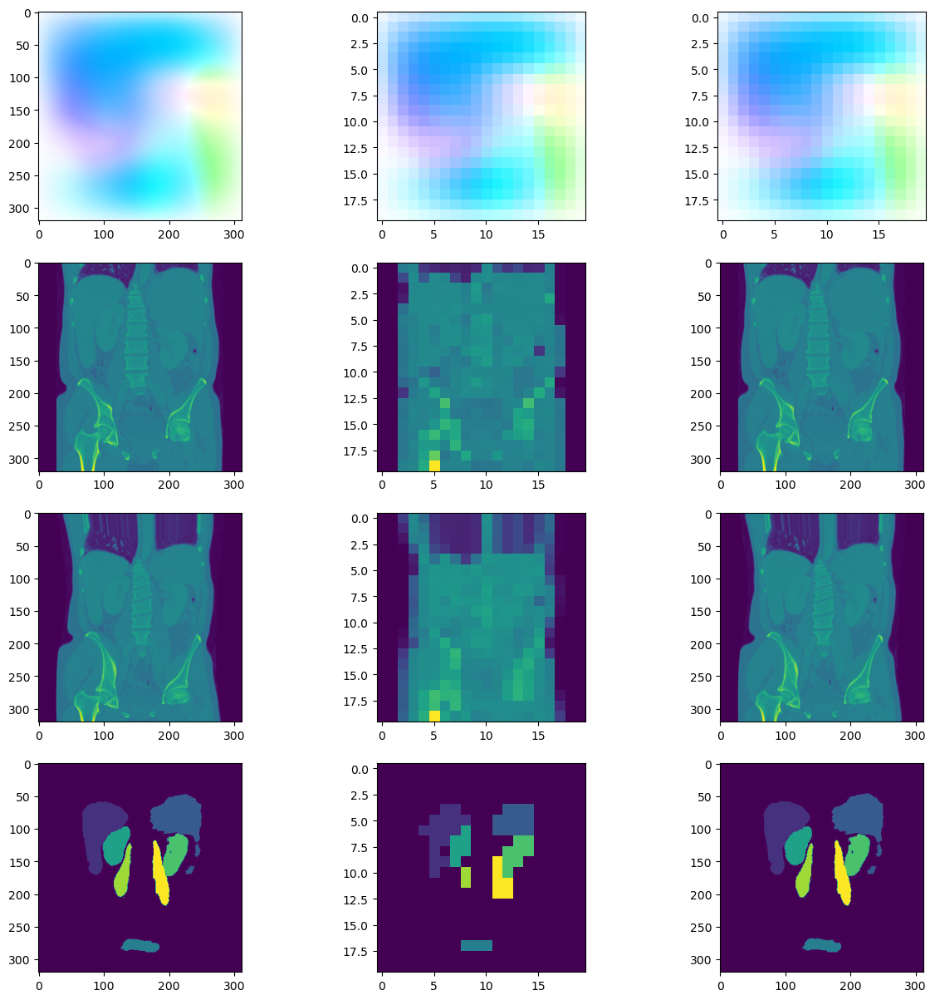

In [ ]:
from src.network_blocks import SpatialTransformer

print("x.shape", x.shape)
# interpolate the df to make it smaller
print("df_pred.shape", combined_dfs[3].shape)
small_x = F.interpolate(x, size=(20, 20), mode="bilinear", align_corners=False)# / 16 / 16
big_x = F.interpolate(x, size=combined_dfs[3].shape[2:], mode="bilinear", align_corners=False)# * 16
# print the max values of the three x
print("max values of x", torch.max(x))
print("max values of small_x", torch.max(small_x))
print("max values of big_x", torch.max(big_x))

################ SEGMENTATION ################
# interpolate the seg to make it smaller
print("seg_x.shape", seg_x.shape)
small_seg_y = F.interpolate(seg_y, size=(20, 20), mode="bilinear", align_corners=False)
small_seg_x = F.interpolate(seg_x, size=(20, 20), mode="bilinear", align_corners=False)
big_seg_x = F.interpolate(small_seg_x, size=combined_dfs[3].shape[2:], mode="bilinear", align_corners=False)


small_df = F.interpolate(combined_dfs[3], size=(20, 20), mode="bilinear", align_corners=False) / 16
print("small_df.shape", small_df.shape)
big_df = F.interpolate(small_df, size=combined_dfs[3].shape[2:] , mode="bilinear", align_corners=False) * 16
print("big_df.shape", big_df.shape)
# print the max values of a three dfs
print("max values of df_pred", torch.max(combined_dfs[3]))
print("max values of small_df", torch.max(small_df))
print("max values of big_df", torch.max(big_df))

fig,ax = plt.subplots(4,3, figsize=(15,15))
# show the df as flow image
ax[0,0].imshow(flow_to_image(combined_dfs[3]).permute(0,2,3,1)[0])
ax[0,1].imshow(flow_to_image(small_df).permute(0,2,3,1)[0])
# ax[0,2].imshow(flow_to_image(big_df).permute(0,2,3,1)[0])
ax[0,2].imshow(flow_to_image(F.interpolate(big_df, size=(20, 20), mode="bilinear", align_corners=False) / 16).permute(0,2,3,1)[0])

# show the big and the small x
ax[1,0].imshow(x[0][0])
ax[1,1].imshow(small_x[0][0])
ax[1,2].imshow(big_x[0][0])

# # transform the image x with the dfs and plot them
transformerbig = SpatialTransformer(x.shape[2:], mode='bilinear')
transformersmall = SpatialTransformer(small_df.shape[2:], mode='bilinear')

print("max values of transformersmall(small_df,small_x)", torch.max(transformersmall(small_df,small_x)))
ax[2,0].imshow(transformerbig(combined_dfs[3],x)[0][0])
# ax[2,1].imshow(F.interpolate(transformersmall(small_df,small_x), 
#                              size=big_x.shape[2:], mode="bilinear", align_corners=False)[0][0])
ax[2,1].imshow(transformersmall(small_df,small_x)[0][0])
ax[2,2].imshow(transformerbig(big_df,x)[0][0])

# print MSE of x and transformed x
print("MSE of x and transformed x normal", torch.mean((transformerbig(combined_dfs[3],x) - x)**2))
print("MSE of x and transformed x small", torch.mean((transformersmall(small_df,small_x) - small_x)**2))
print("MSE of x and transformed x big again", torch.mean((transformerbig(big_df,x) - big_x)**2))


###### SEGMENTATION ######
# transform the seg_x with the dfs and plot them

# ax[3,0].imshow(seg_x[0].argmax(0))
# ax[3,1].imshow(small_seg_x[0].argmax(0))
# ax[3,2].imshow(seg_x[0].argmax(0))

ax[3,0].imshow(transformerbig(combined_dfs[3],seg_x)[0].argmax(0))
ax[3,1].imshow(transformersmall(small_df,small_seg_x)[0].argmax(0))
ax[3,2].imshow(transformerbig(big_df,seg_x)[0].argmax(0))

# print dice loss of seg_y and transformed seg_x
print(transformerbig(combined_dfs[3],seg_x).shape, seg_y.shape)
print("Dice of seg_y and seg_x normal", 
      Soft_dice_loss(seg_x, seg_y))
print("Dice of seg_y and transformed seg_x normal", 
      Soft_dice_loss(transformerbig(combined_dfs[3],seg_x), seg_y))
print("Dice of seg_y and seg_x small",
        Soft_dice_loss(small_seg_x, small_seg_y))
print("Dice of seg_y and transformed seg_x small",
        Soft_dice_loss(transformersmall(small_df,small_seg_x), small_seg_y))


All flowimage directions in clockwise circle, starting from top/red

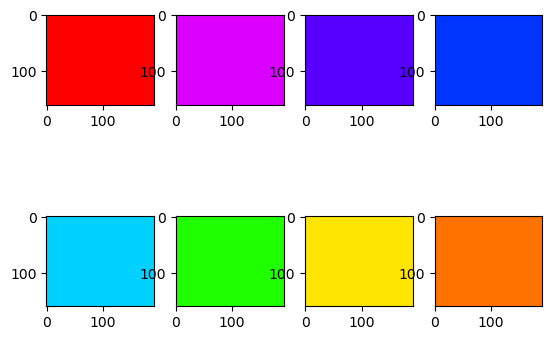

In [ ]:
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas

fig, ax = plt.subplots(2,4)
canvas = FigureCanvas(fig)


# # create a simple plot
# x = np.linspace(0, 10, 100)
# y = np.sin(x)
# plt.plot(x, y)

# # create a new figure and get its canvas
# fig = plt.figure()
# canvas = fig.canvas

# # update the canvas and get the renderer
# canvas.draw()
# renderer = canvas.get_renderer()

# # get the RGBA buffer from the renderer
# raw_data = renderer.buffer_rgba()

# # convert the raw data into a NumPy array
# image = np.frombuffer(raw_data, dtype=np.uint8)
# image = image.reshape(canvas.get_width_height()[::-1] + (4,))

# # display the image
# plt.imshow(image)
# plt.show()


#create deformation field that translates downwards
df = torch.zeros_like(df_pred)

# 0 ist runter, 1 ist rechts
# negative means down/right, positive means up/left
df[0,0] = 100
df[0,1] = 0
ax[0,0].imshow(flow_to_image(df)[0].permute(1,2,0))
df[0,0] = 100
df[0,1] = -100
ax[0,1].imshow(flow_to_image(df)[0].permute(1,2,0))
df[0,0] = 0
df[0,1] = -100
ax[0,2].imshow(flow_to_image(df)[0].permute(1,2,0))
df[0,0] = -100
df[0,1] = -100
ax[0,3].imshow(flow_to_image(df)[0].permute(1,2,0))
df[0,0] = -100
df[0,1] = 0
ax[1,0].imshow(flow_to_image(df)[0].permute(1,2,0))
df[0,0] = -100
df[0,1] = 100
ax[1,1].imshow(flow_to_image(df)[0].permute(1,2,0))
df[0,0] = 0
df[0,1] = 100
ax[1,2].imshow(flow_to_image(df)[0].permute(1,2,0))
df[0,0] = 100
df[0,1] = 100
ax[1,3].imshow(flow_to_image(df)[0].permute(1,2,0))

canvas.draw()
buf = canvas.buffer_rgba()
# convert to a NumPy array
X = np.asarray(buf)
# print(X)

            

/tmp/ipykernel_24461/1496776362.py:32: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  im = ax.pcolormesh(t, r, c.T, cmap = cmap,norm=norm)  #plot the colormesh on axis with colormap
/tmp/ipykernel_24461/1496776362.py:43: UserWarning: The label '_child0' of <matplotlib.collections.QuadMesh object at 0x7f58ebf31c00> starts with '_'. It is thus excluded from the legend.
  ax.legend(handles=[im], loc='right')


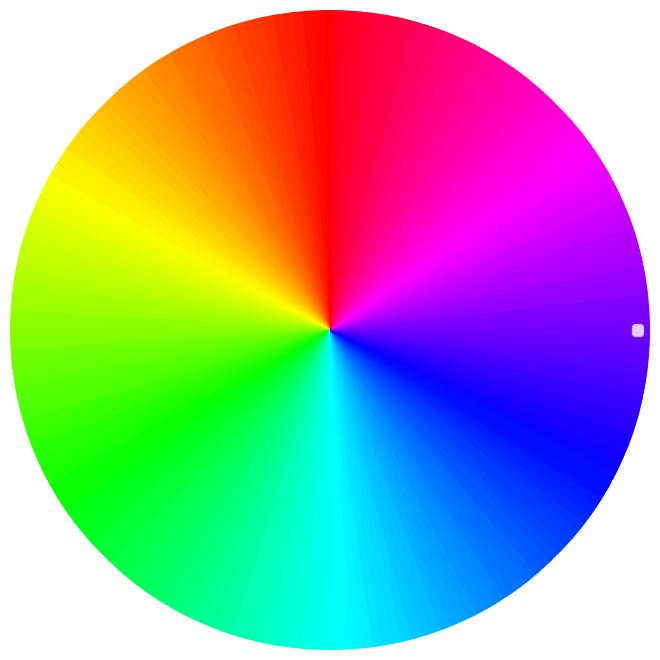

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import cm
import matplotlib as mpl
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas


# If displaying in a Jupyter notebook:
# %matplotlib inline 

# Generate a figure with a polar projection
fg = plt.figure(figsize=(8,8))
ax = fg.add_axes([0.1,0.1,0.8,0.8], projection='polar')
canvas = FigureCanvas(fg)


# Define colormap normalization for 0 to 2*pi
norm = mpl.colors.Normalize(0, 2*np.pi) 

cmap = cm.get_cmap('hsv', lut=360)
myrange = np.concatenate((np.linspace(0.75, 1, 90), np.linspace(0, 0.75, 270)))
cmap = mpl.colors.LinearSegmentedColormap.from_list("", cmap(myrange))

# Plot a color mesh on the polar plot
# with the color set by the angle

n = 200  #the number of secants for the mesh
t = np.linspace(0,2*np.pi,n)   #theta values
r = np.linspace(0,1,2)        #radius values change 0.6 to 0 for full circle
rg, tg = np.meshgrid(r,t)      #create a r,theta meshgrid
c = tg                         #define color values as theta value
im = ax.pcolormesh(t, r, c.T, cmap = cmap,norm=norm)  #plot the colormesh on axis with colormap
ax.set_xticklabels([])                   #turn of radial tick labels (yticks)
ax.set_yticklabels([])                   #turn of radial tick labels (yticks)
ax.spines['polar'].set_visible(False)    #turn off the axis spine.

canvas.draw()
buf = canvas.buffer_rgba()
# convert to a NumPy array
X = np.asarray(buf)
# print(X)

ax.legend(handles=[im], loc='right')


NameError: name 'canvas' is not defined

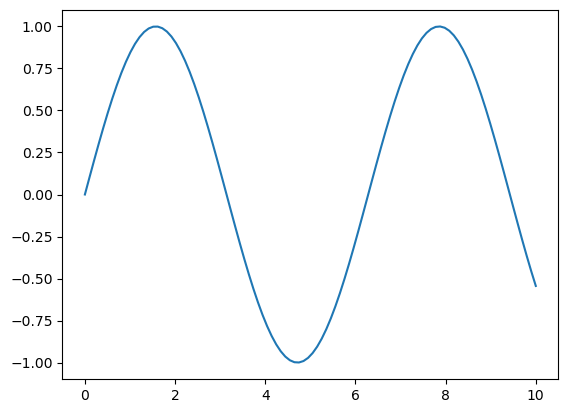

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.legend_handler import HandlerBase
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas

# create a plot
x = np.linspace(0, 10, 100)
y = np.sin(x)
plt.plot(x, y, label='sin(x)')

# create another plot
z = np.cos(x)
plt.plot(x, z, label='cos(x)')

# create a legend with the first plot as the label and the second plot as the legend
legend_plot = plt.plot([],[], label='sin(x) as legend')
plt.legend(handles=[legend_plot[0]], loc='upper right')

plt.show()

AttributeError: 'list' object has no attribute 'get_array'

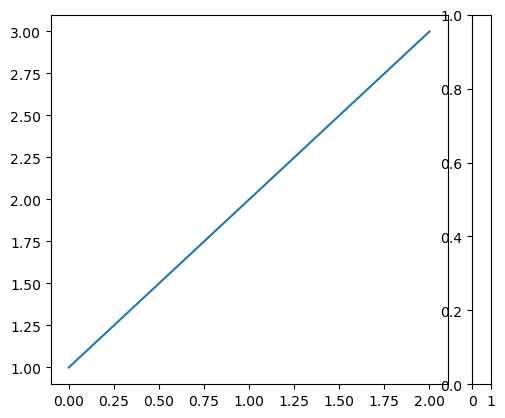

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Generate some data to plot
x = np.linspace(0, 10, 100)
y = np.sin(x)

# Create a figure and axis object
fig, ax = plt.subplots()

cmap = cm.get_cmap('hsv', lut=360)
print(cmap)

# Create a scatter plot with colors mapped using the 'hsv' color map starting with blue
sc = ax.scatter(x, y, c=x, cmap='hsv', vmin=0.05, vmax=1)

# Create a color bar with the 'hsv' color map
cbar = plt.colorbar(sc, ax=ax)

# Set the label for the color bar
cbar.set_label('Color Label')

print(cbar.get_ticks())
# cbar.set_ticks([0,90,180,270,360])
cbar.set_ticklabels([0,1,2,"\u2191","right","up"])

# Show the plot
plt.show()

Which layers contribute to which error?

In [ ]:
for l in reversed(range(latent_levels)):
    output_seg = model.apply_transform(combined_dfs[l].clone(), seg_x)
    print(f"On level {l}: MSE loss: {L2_loss(outputs[l],y)} and dice loss: {Soft_dice_loss(output_seg,seg_y)}")

On level 3: MSE loss: 945.8588256835938 and dice loss: 0.28574880957603455
On level 2: MSE loss: 616.8602294921875 and dice loss: 0.13220426440238953
On level 1: MSE loss: 536.0602416992188 and dice loss: 0.08768629282712936
On level 0: MSE loss: 487.3311767578125 and dice loss: 0.07172068953514099


Plot input, prediction and target:

In [ ]:
# maxseg_x = seg_x[0].argmax(0)
# maxseg_y = seg_y[0].argmax(0)
# max_y_pred_seg = y_pred_seg[0].argmax(0)

# rows = 2
# cols = 4
# fig, ax = plt.subplots(rows,cols)
# fig.set_figwidth(30)
# fig.set_figheight(30 * rows/latent_levels)
# for r in range(rows):
#     for c in range(cols):
#         # ax[r,c].axis("off")ax1.
#         ax[r,c].set_xticks([], [])  # note you need two lists one for the positions and one for the labels
#         ax[r,c].set_yticks([], [])
    
# ax[0,0].imshow(x[0,0], "gray")
# ax[0,1].imshow(y_pred[0,0], "gray")
# ax[0,2].imshow(y[0,0], "gray")
# ax[0,3].imshow(flow_to_image(combined_dfs[0]).permute(0,2,3,1)[0])
# # ax[0].imshow(maxseg_x, alpha=.3*(maxseg_x>0))
# # ax[1].imshow(max_y_pred_seg, alpha=.3*(max_y_pred_seg>0))
# # ax[2].imshow(maxseg_y, alpha=.3*(maxseg_y>0))

# ax[1,0].imshow(maxseg_x)
# ax[1,1].imshow(max_y_pred_seg)
# ax[1,2].imshow(maxseg_y)
# ax[1,3].imshow(flow_to_image(combined_dfs[0]).permute(0,2,3,1)[0])

# for i in range(rows):
#     ax[i,0].set_xlabel("Input")
#     ax[i,1].set_xlabel("Prediction")
#     ax[i,2].set_xlabel("Target")
#     ax[i,3].set_xlabel("DF")     

Plot the intermediate output of each level, the combined dfs, and the individual dfs:

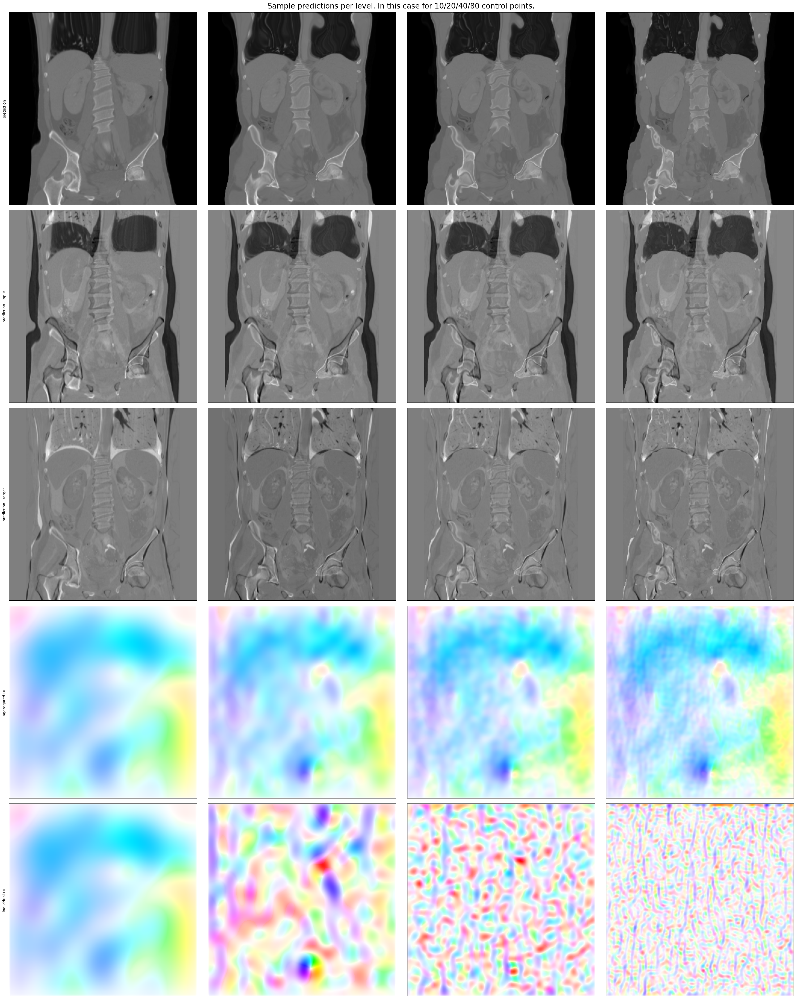

In [ ]:
rows = 5
cols = latent_levels
fig, ax = plt.subplots(rows,cols,constrained_layout=True)
fig.set_figwidth(30)
fig.set_figheight(30 * rows/cols)
fig.suptitle(" Sample predictions per level. In this case for 10/20/40/80 control points.",fontsize=20)
for r in range(rows):
    for c in range(cols):
        ax[r,c].set_xticks([], [])
        ax[r,c].set_yticks([], [])
ax[0,0].set_ylabel("prediction")
ax[1,0].set_ylabel("prediction - input")
ax[2,0].set_ylabel("prediction - target")
ax[3,0].set_ylabel("aggregated DF")
ax[4,0].set_ylabel("individual DF")


for l in reversed(range(latent_levels)):
    # the outputs of each level
    ax[0,latent_levels-l-1].imshow(outputs[l][0,0], "gray")
    # the absolute difference of outputs and input image
    ax[1,latent_levels-l-1].imshow(outputs[l][0,0] - x[0,0], "gray")
    # the absolute difference of outputs and target image
    ax[2,latent_levels-l-1].imshow(outputs[l][0,0] - y[0,0], "gray")
    # print(combined_dfs[l][0,0,0,:12])
    # the combined dfs
    ax[3,latent_levels-l-1].imshow(flow_to_image(combined_dfs[l]).permute(0,2,3,1)[0])
    # the dfs of just each level
    ax[4,latent_levels-l-1].imshow(flow_to_image(dfs[l]).permute(0,2,3,1)[0])

Sample several and compare

In [ ]:
num_samples = 4

input = next(iter(test_loader))
x = input[0]
y = input[1]
seg_x = input[2]
seg_y = input[3]

xb = torch.vstack([x for _ in range(num_samples)])
yb = torch.vstack([y for _ in range(num_samples)])

outputs, dfs = model.predict(xb,yb)
print(outputs[0].shape)
print(dfs[0].shape)

y_pred = outputs[0].detach().numpy()



torch.Size([4, 1, 320, 312])
torch.Size([4, 2, 320, 312])


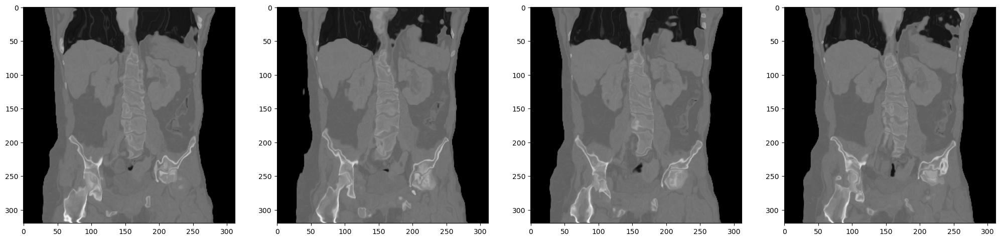

In [ ]:
fig, ax = plt.subplots(1,num_samples)
fig.set_figwidth(25)
fig.set_figheight(20)

for s in range(num_samples):
    ax[s].imshow(y_pred[s,0], "gray")
    # ax[s].imshow(seg_y[0].argmax(0), alpha=.3*(seg_y[0].argmax(0)>0))


Create a Heatmap of the pixel-wise standard deviation:

In [ ]:
num_samples = 20

input = next(iter(test_loader))
x = input[0]
y = input[1]
# blur part of the target
# y[0,0,100:250,20:150] = y.mean()
# y[:] = y.mean()
seg_x = input[2]
seg_y = input[3]

xb = torch.vstack([x for _ in range(num_samples)])
yb = torch.vstack([y for _ in range(num_samples)])

outputs, dfs = model.predict(xb,yb)
print(dfs[0].shape)
preds = outputs[0].detach()
std = torch.std(preds, axis=0)[0].numpy()
print(std.shape)

torch.Size([20, 2, 320, 312])
(320, 312)


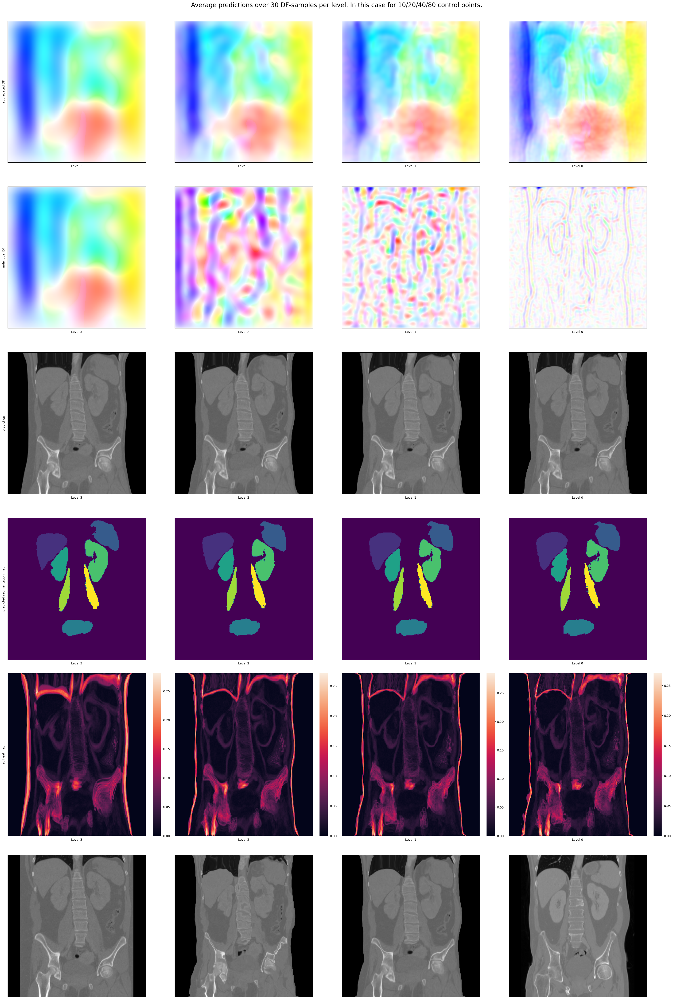

In [ ]:
rows = 6
cols = latent_levels
fig, ax = plt.subplots(rows,cols,constrained_layout=True)
fig.set_figwidth(30)
fig.set_figheight(30 * rows/cols)
fig.suptitle("Average predictions over 30 DF-samples per level. In this case for 10/20/40/80 control points.",fontsize=20)

latent_levels = len(outputs)
combined_dfs = {}
avg_dfs = {}
avg_individual_dfs = {}
# detach all outputs and combine the dfs
for l in reversed(range(latent_levels)):
    outputs[l] = outputs[l].detach()
    dfs[l] = dfs[l].detach()
    if l+1 in combined_dfs:
        combined_dfs[l] = dfs[l].clone() + combined_dfs[l+1].clone()
    else:
        combined_dfs[l] = dfs[l].clone()
    
    avg_dfs[l] = combined_dfs[l].clone().mean(0).unsqueeze(0)
    avg_individual_dfs[l] = dfs[l].clone().mean(0).unsqueeze(0)

    avg_ypred = model.apply_transform(avg_dfs[l],x)
    std = torch.std(outputs[l], axis=0)[0].numpy()

    y_pred_seg = model.apply_transform(avg_dfs[l].clone(), seg_x)[0].argmax(0)

    ax[0, latent_levels-l-1].imshow(flow_to_image(avg_dfs[l]).permute(0,2,3,1)[0])
    ax[1, latent_levels-l-1].imshow(flow_to_image(avg_individual_dfs[l]).permute(0,2,3,1)[0])
    ax[2, latent_levels-l-1].imshow(avg_ypred[0,0],"gray")
    ax[3, latent_levels-l-1].imshow(y_pred_seg)
    sns.heatmap(std, ax=ax[4, latent_levels-l-1])


    ax[0,latent_levels-l-1].set_xlabel(f"Level {l}")
    ax[1,latent_levels-l-1].set_xlabel(f"Level {l}")
    ax[2,latent_levels-l-1].set_xlabel(f"Level {l}")
    ax[3,latent_levels-l-1].set_xlabel(f"Level {l}")
    ax[4,latent_levels-l-1].set_xlabel(f"Level {l}")


ax[5,0].imshow(x[0,0], "gray")
ax[5,1].imshow(preds[0,0], "gray")
ax[5,2].imshow(avg_ypred[0,0], "gray")
ax[5,3].imshow(y[0,0], "gray")

ax[0,0].set_ylabel("aggregated DF")
ax[1,0].set_ylabel("individual DF")
ax[2,0].set_ylabel("prediction")
ax[3,0].set_ylabel("predicted segmentation map")
ax[4,0].set_ylabel("sd heatmap")

for r in range(rows):
    for c in range(cols):
        ax[r,c].set_xticks([], [])
        ax[r,c].set_yticks([], [])
plt.show()

